In [1]:
%load_ext autoreload
%autoreload 2

import scanpy as sc
import yaml
import json
import os
import sys
sys.path.append('../')
sys.path.append('../hovernet')
sys.path.append('../deconvplugin')

PATH = '/home/luca/Documents/data/'
# '/cluster/CBIO/data1/lgortana/'
# '/home/luca/Documents/data_CBIO/'
# '/home/luca/Documents/data/'

/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Data information

In [2]:
import torch

#load adata
adata_name = 'Xenium_V1_humanLung_Cancer_FFPE'
data_path = os.path.join(PATH, adata_name)
path_ST_adata = os.path.join(data_path, 'sim/pseudo_data.h5ad')
adata = sc.read_h5ad(path_ST_adata) #read_visium or read_h5ad

#image path
image_path = os.path.join(data_path, 'tif/Xenium_V1_humanLung_Cancer_FFPE_he_image.ome.tif')
image_dict = torch.load(os.path.join(data_path, "image_dict_64.pt"))

In [3]:
#load image infos
json_path = os.path.join(data_path, 'sim/pannuke_fast_mask_lvl3_annotated.json')
with open(json_path) as json_file:
    hovernet_dict = json.load(json_file)

In [4]:
import pandas as pd

#load spot proportions
spot_prop_df = pd.read_csv(os.path.join(data_path, 'sim/sim_Xenium_V1_humanLung_Cancer_FFPE_prop.csv'), index_col=0)
spot_prop_df.index = spot_prop_df.index.astype(str)
ct_list = list(spot_prop_df.columns)

#load spot dict
with open(os.path.join(data_path, 'sim/spot_dict.json'), "r") as file:
    spot_dict = json.load(file)

#load cell predictions (Tangram annotation)
pred = pd.read_csv(os.path.join(data_path, 'sim/sim_Xenium_V1_humanLung_Cancer_FFPE_pred.csv'), index_col=0)
pred.index = pred.index.astype(str)

In [5]:
from deconvplugin.basics import generate_color_dict
dict_types_colors = generate_color_dict(ct_list, format='special')
dict_types_colors[f'{len(ct_list)}'] = ['nolabe', [0, 0, 0, 255]]

In [6]:
from deconvplugin.postseg import count_cell_types
count_cell_types(hovernet_dict, [item[0] for item in list(dict_types_colors.values())])

,nolabe,malignant cell,fibroblast,endothelial cell,mast cell,T cell,mononuclear phagocyte,epithelial cell,B cell,plasmacytoid dendritic cell,neutrophil
0,89705,12285,3991,2885,2863,9202,5201,4329,5751,2117,2928


# Segmentation analysis
## Plot slide and segmented nuclei

In [7]:
from deconvplugin.postseg import StdVisualizer

plotter = StdVisualizer(image_path=image_path,
                        adata=adata,
                        adata_name=adata_name,
                        seg_dict=hovernet_dict,
                        color_dict=dict_types_colors)

Visium data found.


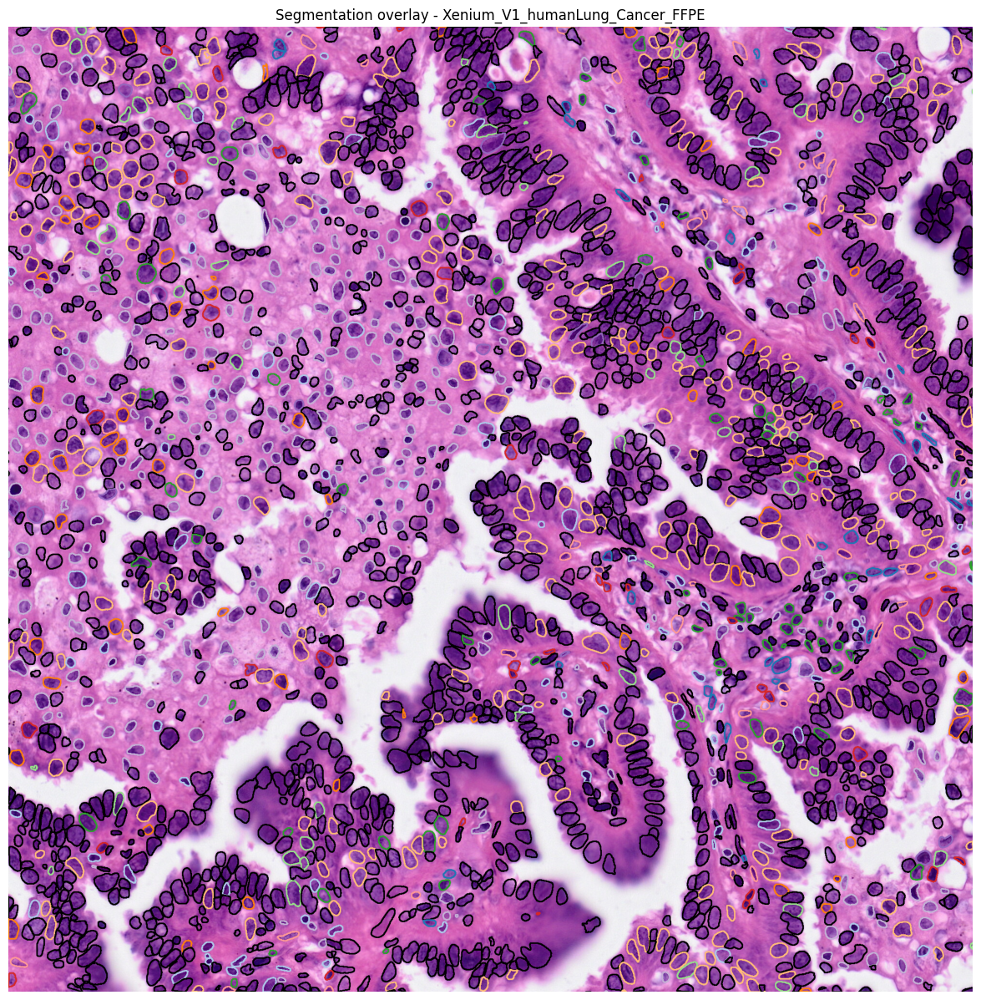

In [8]:
window = ((3000, 20000), (2000, 2000))
plotter.plot_seg(window=window, show_visium=False)

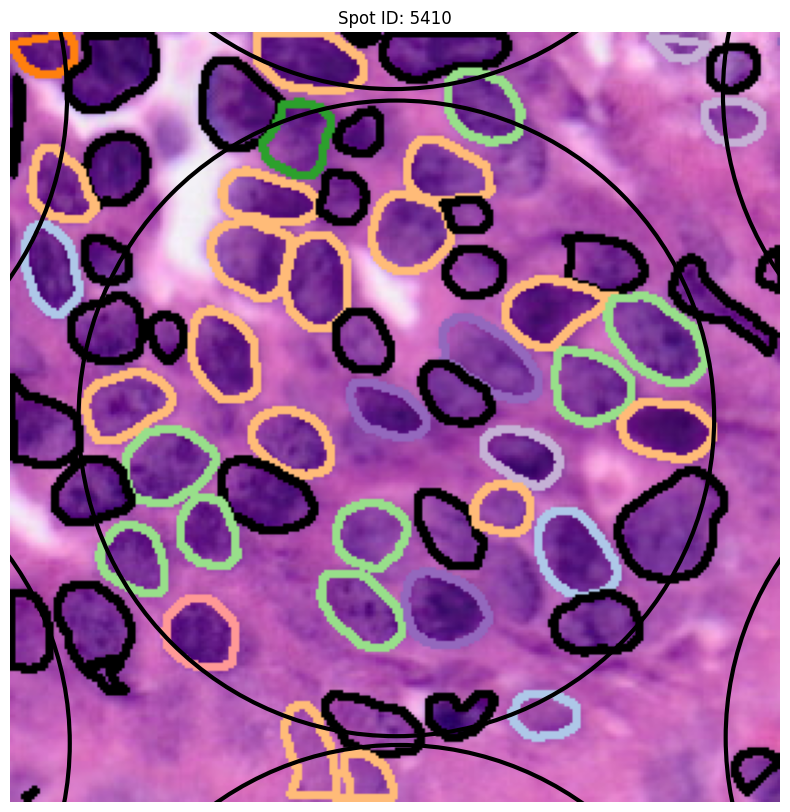

In [9]:
plotter.plot_specific_spot(spot_id='5410')

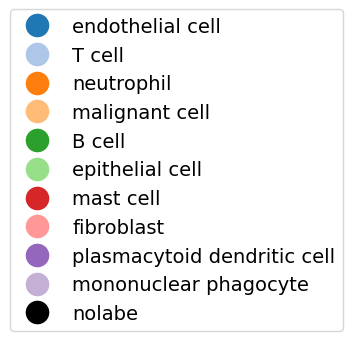

In [10]:
from deconvplugin.plots import plot_legend

plot_legend(dict_types_colors)

In [11]:
from deconvplugin.postseg import IntVisualizer

plotter_int = IntVisualizer(image_path, 
                            adata, 
                            adata_name, 
                            seg_dict=hovernet_dict, 
                            color_dict=dict_types_colors)

Visium data found.


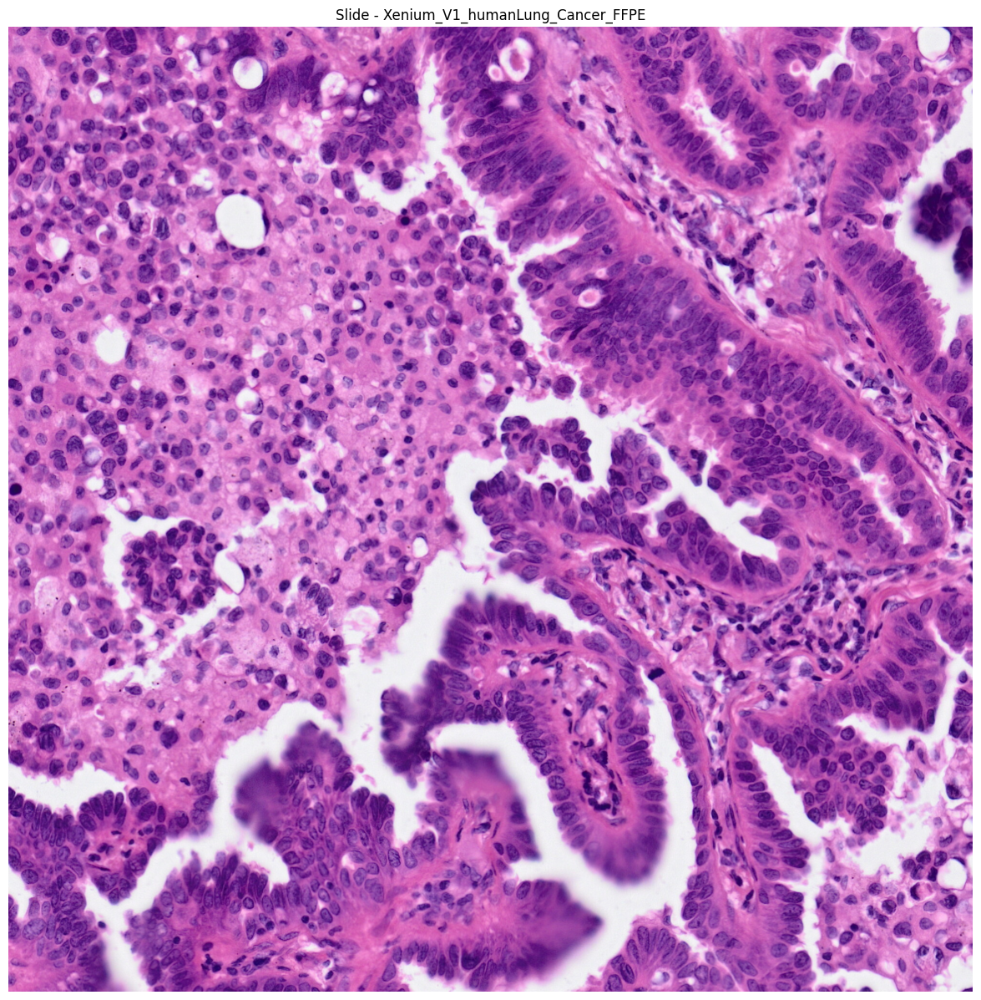

In [12]:
plotter_int.plot_slide(window, show_visium=False)

In [13]:
plotter_int.plot_seg(window, show_visium=False)

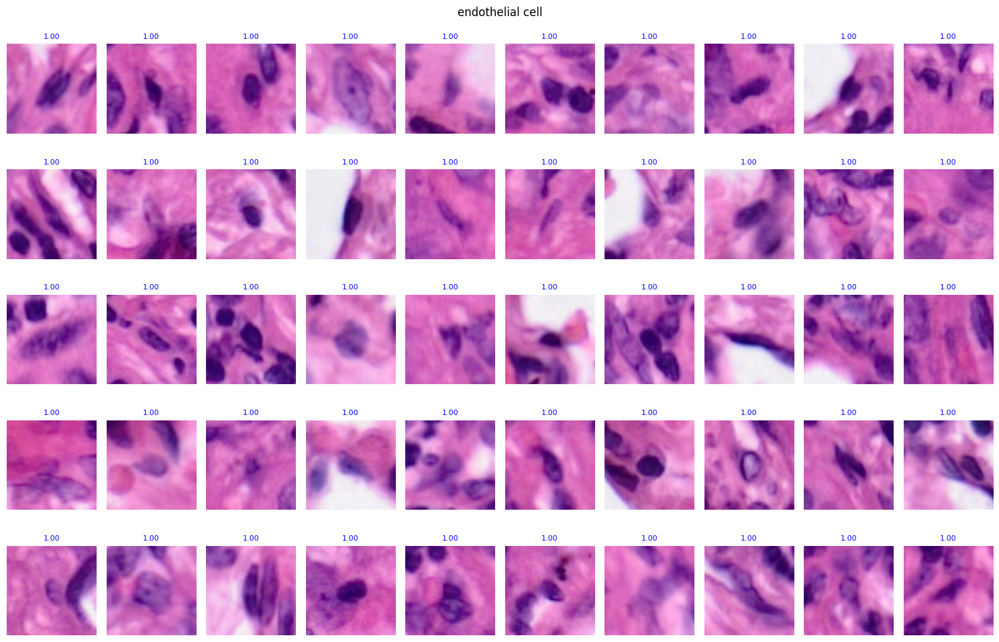

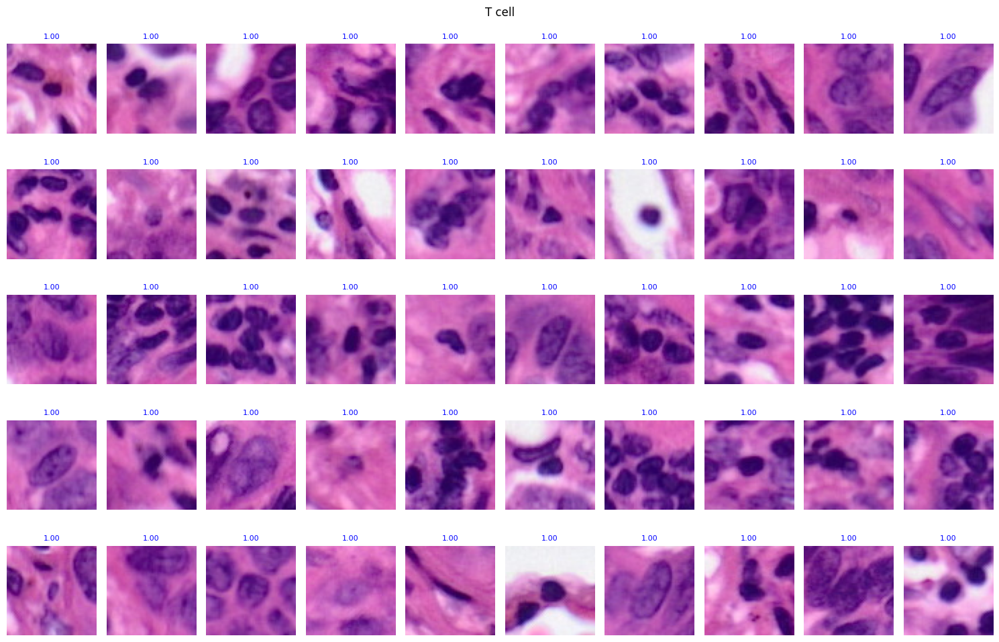

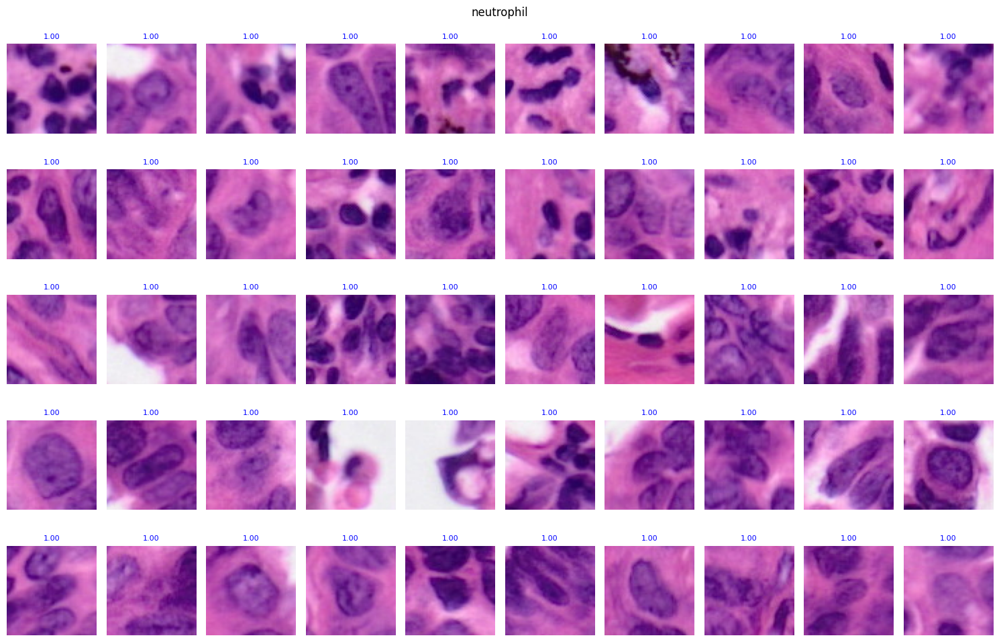

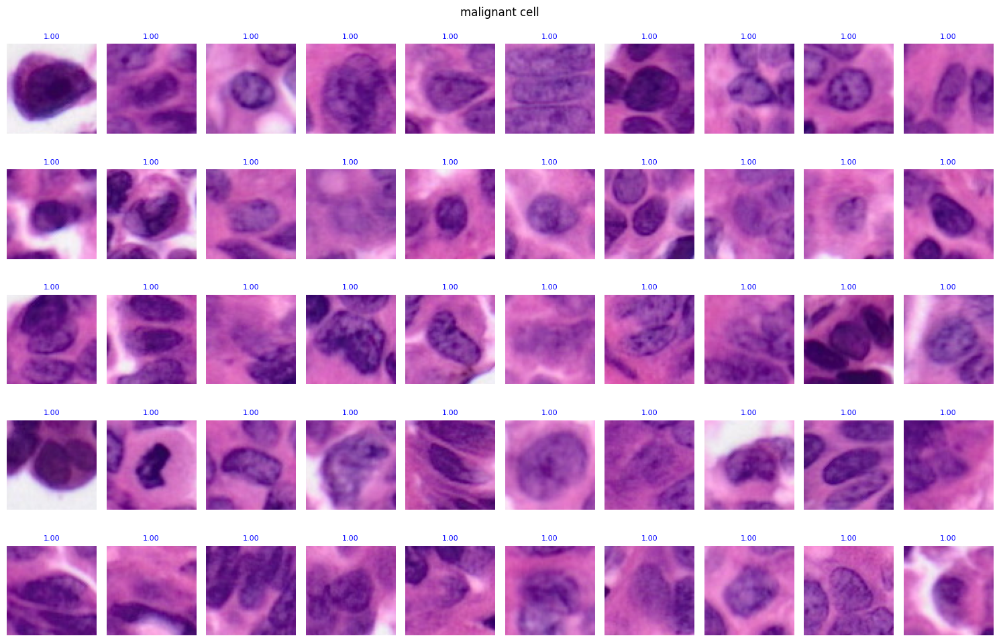

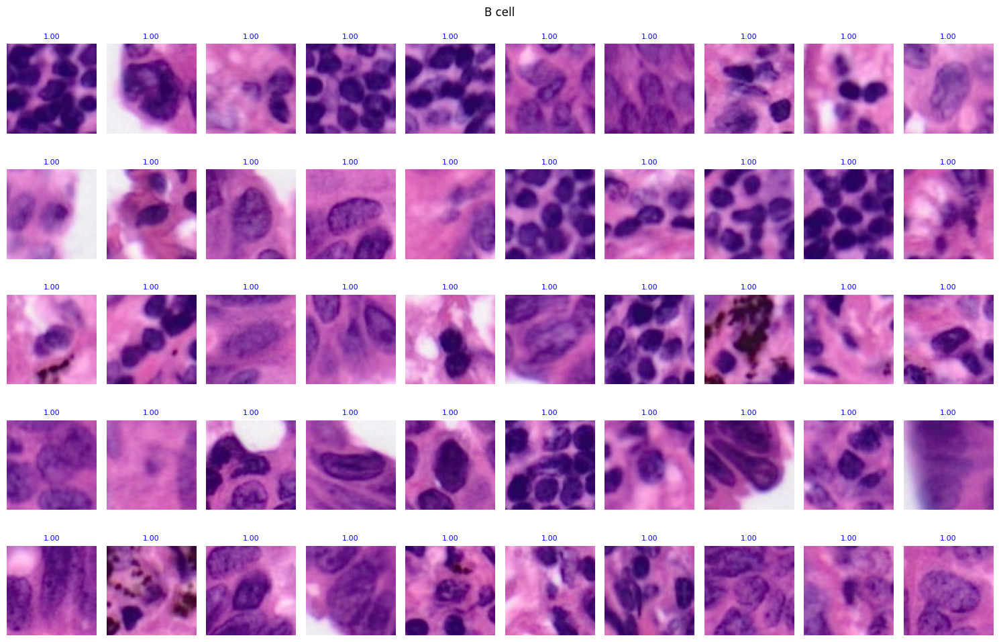

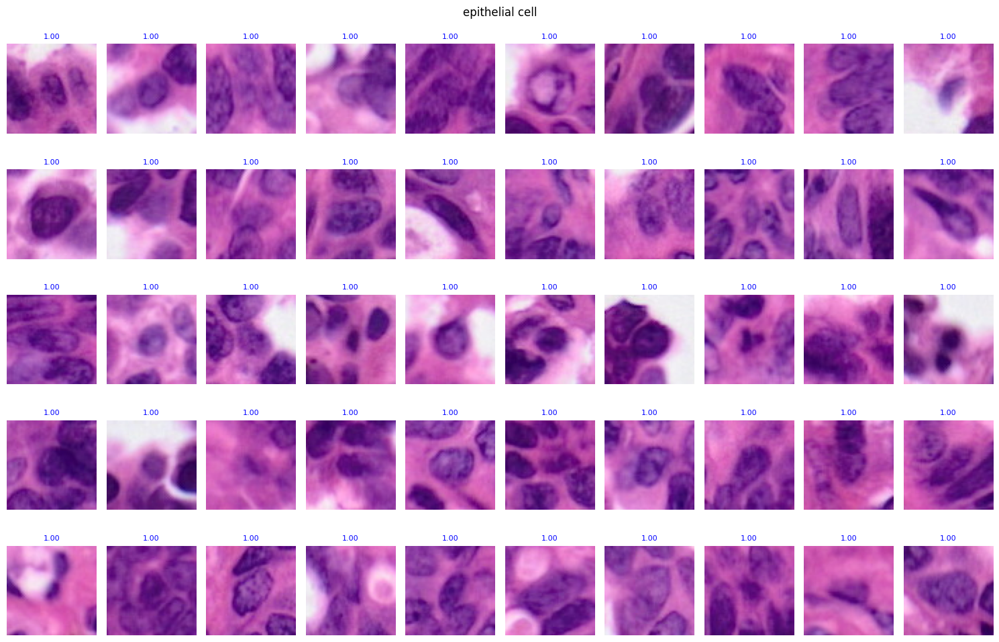

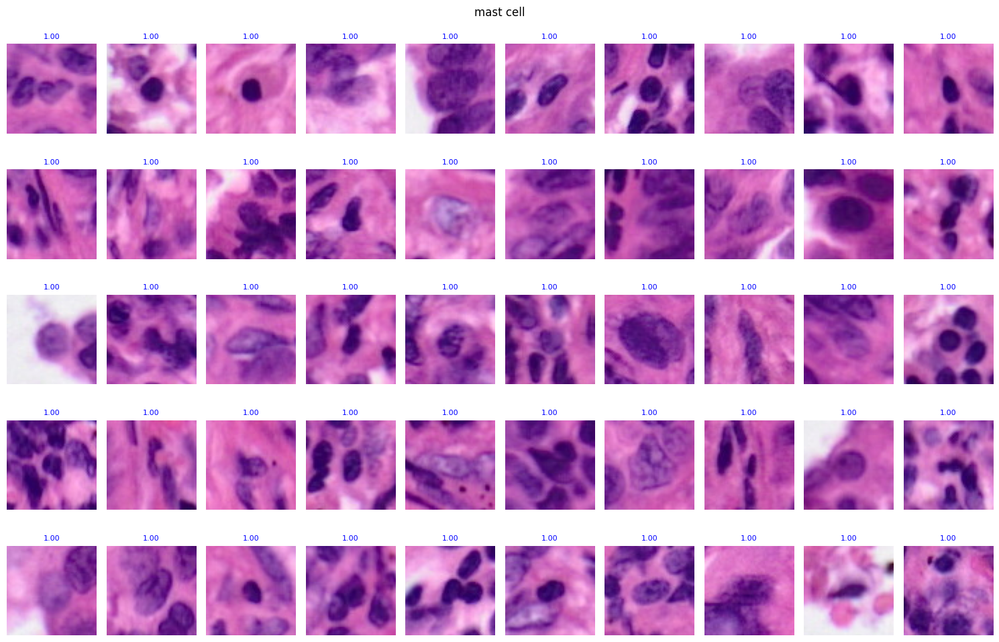

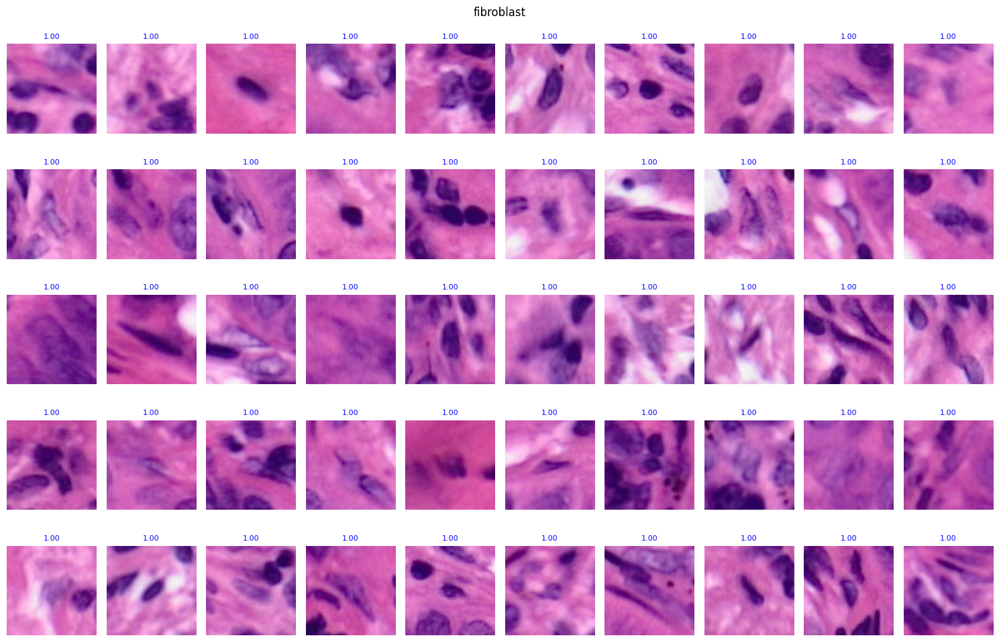

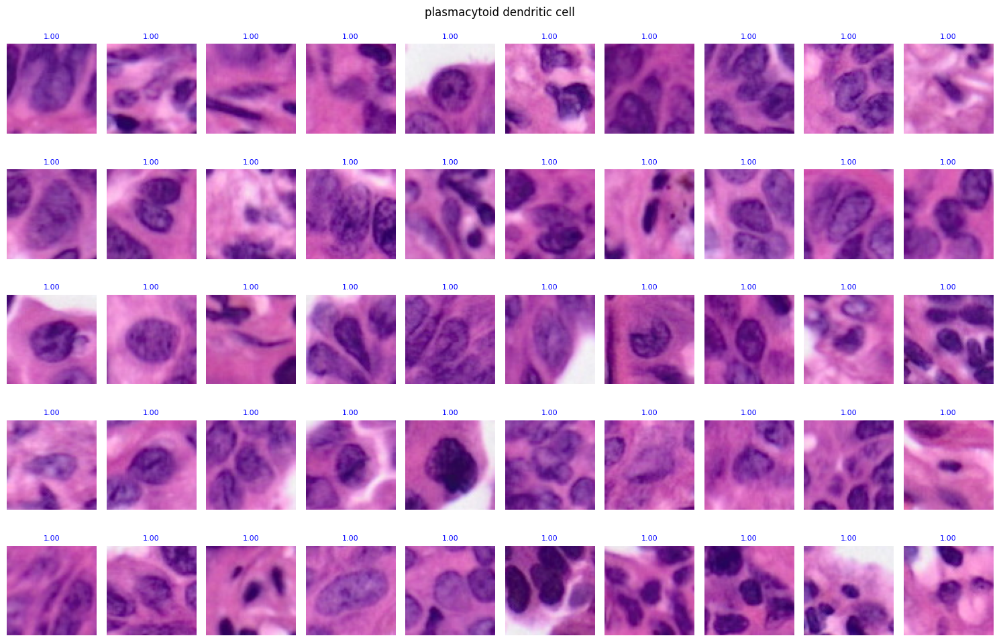

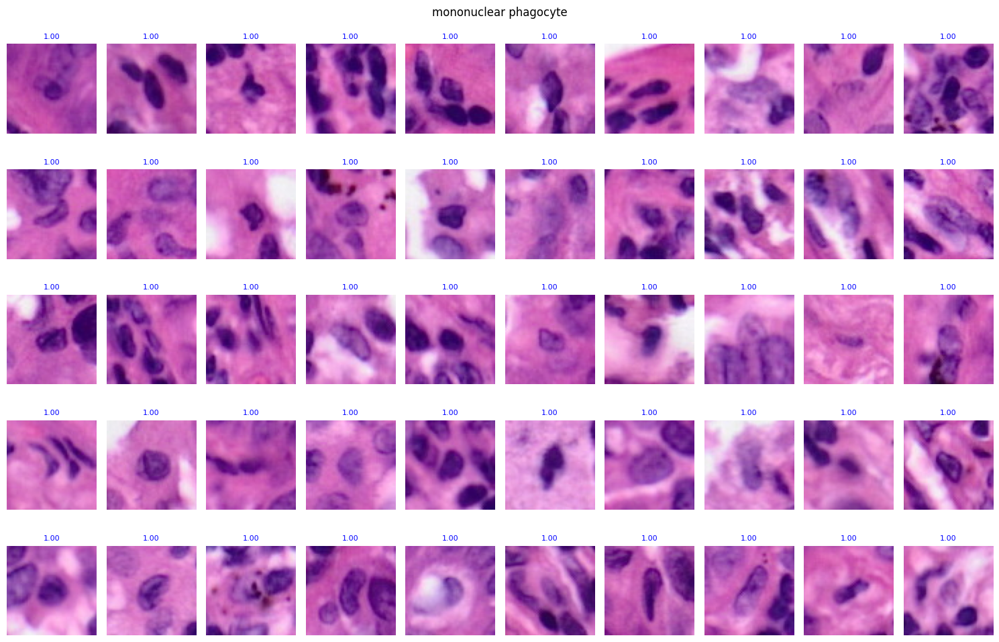

In [14]:
from deconvplugin.plots import plot_grid_celltype

for ct in ct_list:
    plot_grid_celltype(predictions=pred, image_dict=image_dict, cell_type=ct, n=50, selection="random", display=True)

# Map cells to spots

In [41]:
# dict_cell2spot = map_cells_to_spots(adata, adata_name, json_path)

Mapping cells to spots: 100%|██████████| 352093/352093 [00:01<00:00, 221177.99it/s]


# Extract Tiles from HoverNet segmentation

In [ ]:
# level = 0
# size = (64, 64)
# dict_types = {0 : "nolabe", 
#               1 : "neopla", 
#               2 : "inflam", 
#               3 : "connec", 
#               4 : "necros", 
#               5 : "no-neo"}
# out_dir = "data/CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma/img/"

# extract_tiles_hovernet(image_path, json_path, dict_types, out_dir, level, size)

100%|██████████| 352093/352093 [25:06<00:00, 233.76it/s] 
